In [4]:
import scanpy as sc
import squidpy as sq
import numpy as np
import pandas as pd
from anndata import AnnData
import pathlib
import matplotlib.pyplot as plt
import matplotlib as mpl
import skimage
import seaborn as sns
import tangram as tg
import anndata as ad
import re
import math

sc.logging.print_header()
print(f"squidpy=={sq.__version__}")

%load_ext autoreload
%autoreload 2
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

plt.rcParams["svg.fonttype"] = "none"
plt.rcParams["font.family"] = ["sans-serif"]
plt.rcParams["font.sans-serif"] = ["Arial"]
plt.rcParams["pdf.fonttype"] = 42
plt.rcParams["savefig.bbox"]="tight"
plt.rcParams["savefig.format"]='svg'

save_path ='/home/tbou/data/human_dev_face/exports/'


sc.set_figure_params(color_map = 'bwr',vector_friendly=True, format='svg')

scanpy==1.9.3 anndata==0.9.1 umap==0.5.3 numpy==1.23.4 scipy==1.11.1 pandas==2.0.3 scikit-learn==1.3.0 statsmodels==0.14.0 python-igraph==0.10.5 pynndescent==0.5.10
squidpy==1.3.0
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


#### Define variables

In [2]:
face='eye-socket'

library_id='V12U07-297_A1_alltissue'
sc_ref='P24123-1010_w9-5_annotation_transfered_face.h5ad'
base_path='/home/tbou/data/human_dev_face/raw/visium/'+library_id+'/'

# Preprocessing of spatial data A1 W9 eye-periocular

In [3]:
ad_spat = sq.read.visium(base_path+'outs/',)
ad_spat.var_names_make_unique()
ad_spat.var["mt"] = ad_spat.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(ad_spat, qc_vars=["mt"], inplace=True)

sc.pp.normalize_total(ad_spat ,inplace=True)
sc.pp.log1p(ad_spat)

ad_spat.raw=ad_spat

#### Load denoised matrix for clustering

In [5]:
denoised=pd.read_csv(base_path+'/outs/denoised_dca/mean.tsv', sep='\t').T
denoised.columns=denoised.iloc[0]
denoised=denoised.tail(-1)

In [6]:
#Remove duplicates
uniqued=[]
for g in denoised.columns.to_list():
    if (g in uniqued):
        g=str(g)+'_out'
        uniqued.append(g)
        #print('exists')
    else:
        uniqued.append(g)

denoised.columns=uniqued

In [7]:
#keep only comoon genes
genes=[gene for gene in ad_spat.var_names if gene in denoised.columns]
cells=[cell for cell in ad_spat.obs_names if cell in denoised.index]

In [8]:
#add denoised matrix to adata object
denoised=denoised.loc[cells]
denoised=denoised[genes]
ad_spat=ad_spat[cells]
ad_spat=ad_spat[:,genes]

ad_spat.layers['denoised']=denoised


<Axes: xlabel='pct_counts_mt'>

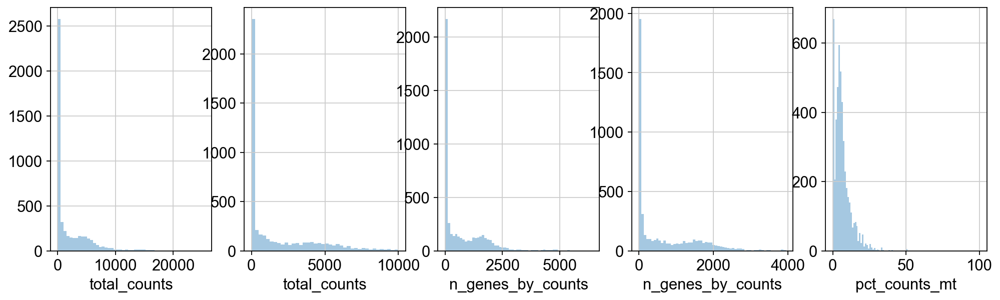

In [9]:
fig, axs = plt.subplots(1, 5, figsize=(15, 4))
sns.distplot(ad_spat.obs["total_counts"], kde=False, ax=axs[0])
sns.distplot(ad_spat.obs["total_counts"][ad_spat.obs["total_counts"] < 10000], kde=False, bins=40, ax=axs[1],)
sns.distplot(ad_spat.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[2])
sns.distplot(ad_spat.obs["n_genes_by_counts"][ad_spat.obs["n_genes_by_counts"] < 4000], kde=False, bins=60, ax=axs[3])
sns.distplot(ad_spat.obs["pct_counts_mt"], kde=False, bins=100, ax=axs[4])

In [10]:
sc.pp.filter_cells(ad_spat, min_counts=250)
sc.pp.filter_cells(ad_spat, max_counts=20000)
ad_spat = ad_spat[ad_spat.obs["pct_counts_mt"] < 20]
print(f"#cells after MT filter: {ad_spat.n_obs}")
sc.pp.filter_genes(ad_spat, min_cells=5)



#cells after MT filter: 2162


<Axes: xlabel='n_genes_by_counts'>

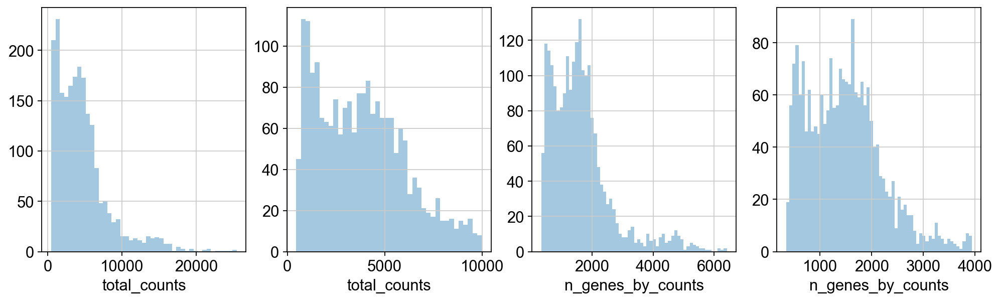

In [11]:
fig, axs = plt.subplots(1, 4, figsize=(15, 4))
sns.distplot(ad_spat.obs["total_counts"], kde=False, ax=axs[0])
sns.distplot(ad_spat.obs["total_counts"][ad_spat.obs["total_counts"] < 10000], kde=False, bins=40, ax=axs[1])
sns.distplot(ad_spat.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[2])
sns.distplot(ad_spat.obs["n_genes_by_counts"][ad_spat.obs["n_genes_by_counts"] < 4000], kde=False, bins=60, ax=axs[3])


In [12]:
sc.pp.normalize_total(ad_spat,layer='denoised' ,inplace=True)
sc.pp.log1p(ad_spat,layer='denoised')
sc.pp.highly_variable_genes(ad_spat, layer='denoised', flavor="seurat", n_top_genes=2000)
ad_spat.obsm['X_pca_denoised']=sc.pp.pca(ad_spat,use_highly_variable=True,copy=True).obsm['X_pca']
sc.pp.neighbors(ad_spat,use_rep ='X_pca_denoised', key_added='denoised' )
    
ad_spat.obsm['X_umap_denoised']=sc.tl.umap(ad_spat,neighbors_key='denoised',copy=True).obsm['X_umap']
sc.tl.leiden(ad_spat,neighbors_key='denoised', key_added="cluster_denoised")

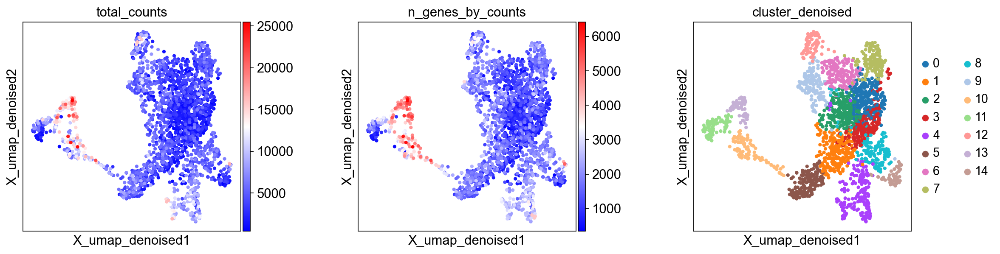

In [13]:
plt.rcParams["figure.figsize"] = (4, 4)
sc.pl.embedding(ad_spat,basis= 'X_umap_denoised', color=["total_counts", "n_genes_by_counts", "cluster_denoised"], wspace=0.4)

In [14]:
scale = ad_spat.uns['spatial'][library_id]['scalefactors']['tissue_hires_scalef'] #important to define scale or it will cause issues down the road
im = sq.im.ImageContainer(ad_spat.uns['spatial'][library_id]['images']['hires'], ## define image for plotting
                           scale=scale, library_id=library_id)

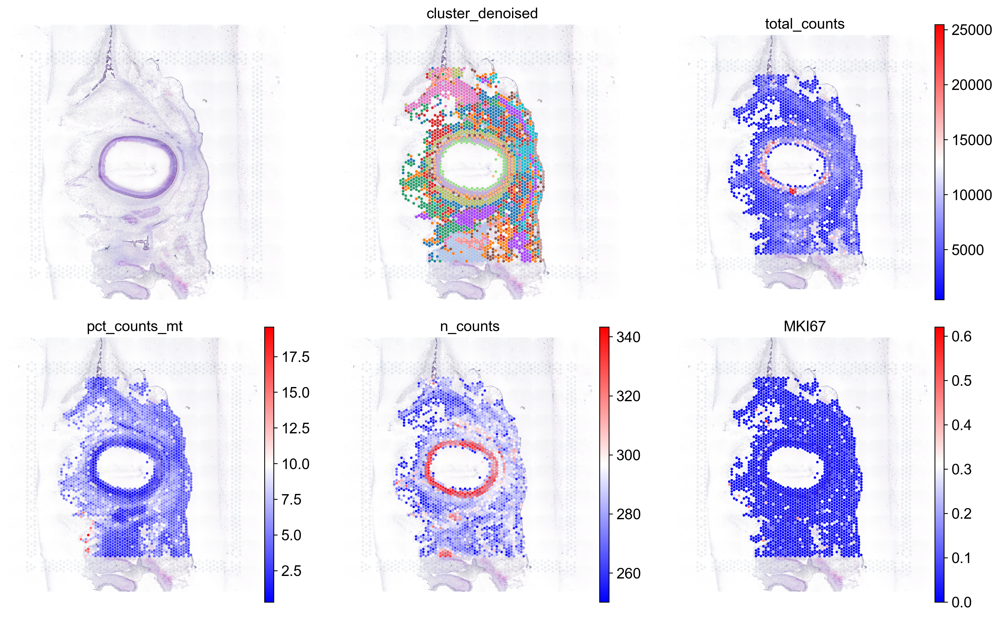

In [15]:
#Plotting of the clusters and the H&E

import math

conditions=[None,'cluster_denoised',"total_counts","pct_counts_mt","n_counts","MKI67"]


ncol=3
nrows=math.ceil(len(conditions)/5)
plt.figure(figsize=(16, 10),dpi=150)
plt.subplots_adjust(hspace=0.1, wspace=.2)

for n, QC in enumerate(conditions):
    
    ax = plt.subplot(nrows, ncol, n + 1)
    
    im.show("image",  ax=ax)
    

    
    sc.pl.spatial(ad_spat, frameon=False,
                  img=None, 
                  color=QC, 
                  show=False,
                  ax=ax,  
                  legend_fontoutline=3,
                  spot_size =60)
    
    ax.legend_ = None
    ax.invert_yaxis()
#plt.savefig(save_path+'embeddings/'+face+'_QC_clustering_spatial_denoised',dpi=150)

In [132]:
#ad_spat.write('/home/tbou/data/human_dev_face/h5ad/070623_A1_eye_socket_visium.h5ad')

# Calculate scores for WGAS genes

In [21]:
genesPV7=pd.read_excel('/home/tbou/data/human_dev_face/AllGenesDistances.xlsx',sheet_name='AllGenesDistancesPV7')
genesPV6=pd.read_excel('/home/tbou/data/human_dev_face/AllGenesDistances.xlsx',sheet_name='AllGenesDistancesPV6')


genesPV7_500k=genesPV7[genesPV7.loc[:,'SNPs in distance of 500kb'] >= 1]
genesPV6_500k=genesPV6[genesPV6.loc[:,'SNPs in distance of 500kb'] >= 1]
genesPV7_50k=genesPV7[genesPV7.loc[:,'Distance'] <= 50000]
genesPV6_50k=genesPV6[genesPV6.loc[:,'Distance'] <= 50000]

gene_lists=[genesPV7_500k,genesPV6_500k,genesPV7_50k,genesPV6_50k]
distance=['500kb','500kb','50kb','50kb']
PVs=['PV7','PV6','PV7','PV6']



# Globalö sum/total counts

In [24]:
#create anndata for caluclations
a=ad_spat.raw.to_adata()
df=pd.concat([pd.DataFrame(data=a.X.toarray(), index=a.obs_names, columns=a.var_names), a.obs], axis=1)

for n in range(len(gene_lists)):
        genes=list(gene_lists[n].loc[:, 'Gene'])
        
        g=[gene for gene in genes if gene in df.columns.to_list()]
        name_score='global_normalized_sum_score_'+str(PVs[n])+'_'+distance[n]
        
        ad_spat.obs[str(name_score)]=df.loc[:,g].sum(axis=1)/a.obs.total_counts
        
       # del genes
        #del g
        del name_score
        
    
#del a
#del df

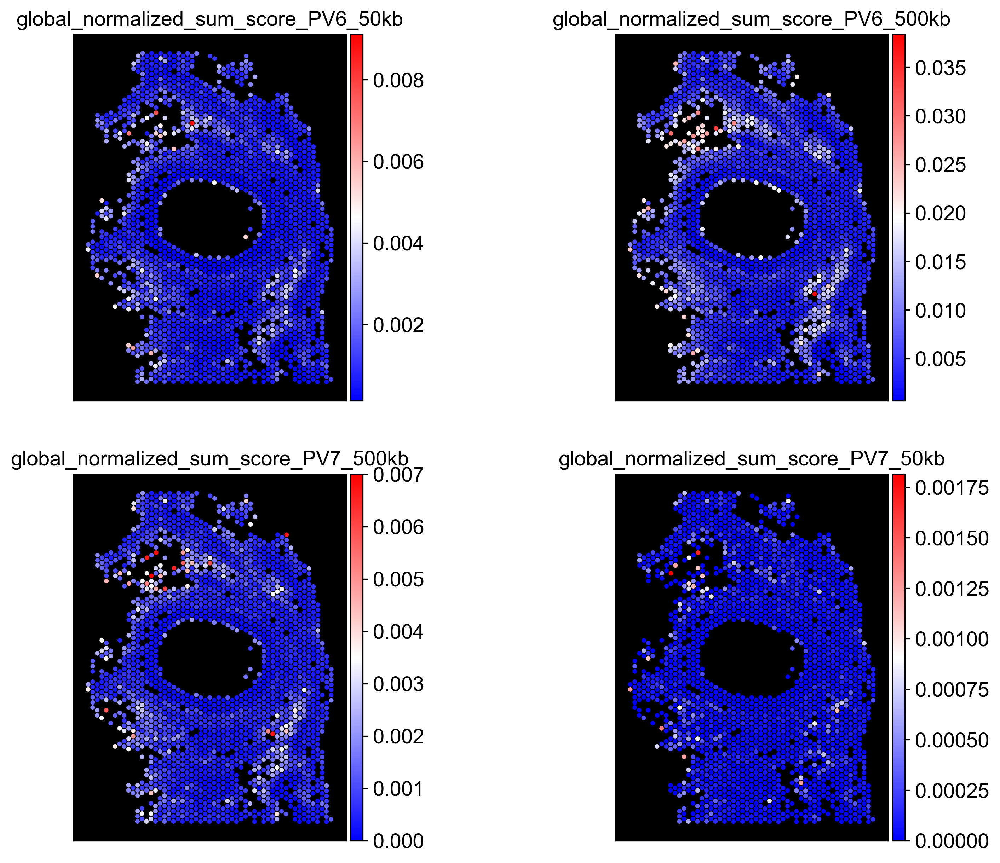

In [25]:

conditions=list(set(ad_spat.obs.columns[ad_spat.obs.columns.str.contains('global_normalized_sum_score_')]))

ncol=2
nrows=2
#fig, ax = plt.subplots(figsize=(ncol*5, nrows*5))
plt.figure(figsize=(12,10),dpi=150)
plt.subplots_adjust(hspace=0.2, wspace=.2)

for n, score in enumerate(conditions):
    
    ax = plt.subplot(nrows, ncol, n + 1)
    
    #im.show(ax=ax)
    

    
    sc.pl.spatial(ad_spat, 
                  frameon=True,
                  img_key=None, 
                  color=score, 
                  show=False,
                  ax=ax,  
                  legend_fontoutline=3,
                  spot_size =60,
                   scale_factor=scale,
                 #cmap='viridis'
                 )
   
    ax.legend_ = None
    _=ax.set_facecolor('black')   
    
    ax.set(xlabel=None, ylabel=None)
    
    #ax.invert_yaxis()
    

#plt.savefig(save_path+'embeddings/'+face+'_WGAS_GLOBAL_NORMALIZED_SUM_scoring_spatial_',dpi=150)

# Individual sum scores

In [36]:
#create anndata for caluclations
a=ad_spat.raw.to_adata()
df=pd.concat([pd.DataFrame(data=a.X.toarray(), index=a.obs_names, columns=a.var_names), a.obs], axis=1)



for n in range(len(PVs)):
    pheno=list(set(gene_lists[n].loc[:,'Triat']))
    
    for p in pheno:
        #print(p)
        genes=list(gene_lists[n][gene_lists[n].loc[:,'Triat']==str(p)].loc[:,'Gene'])
        g=[gene for gene in genes if gene in df.columns.to_list()]
        name_score='sum_score_no_norm_'+str(p)+'_'+str(PVs[n])+'_'+distance[n]
        
        ad_spat.obs[str(name_score)]=df.loc[:,g].sum(axis=1)
        
        del genes
        del g
        del name_score
        
    del pheno
del a
del df


<Figure size 320x320 with 0 Axes>

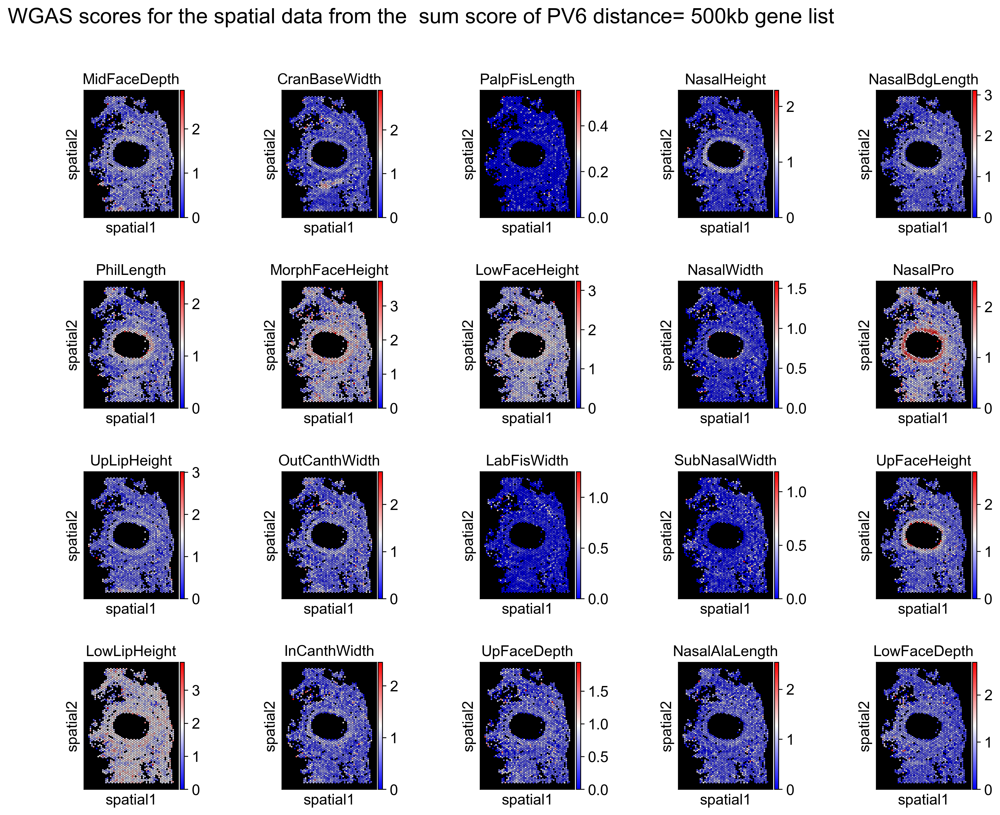

In [39]:
import re

#fig, ax = plt.subplots(figsize=(ncol*5, nrows*5))

plt.subplots_adjust(hspace=.5, wspace=.2)
    
scores=ad_spat.obs.columns[ad_spat.obs.columns.str.contains('PV6_500')]
scores=scores[scores.str.startswith('sum_score_no_norm_')]
ncol=5
nrows=math.ceil(len(scores)/ncol)
plt.figure(figsize=(16, nrows*3),dpi=150)
plt.subplots_adjust(hspace=.5, wspace=.2)
    
for m, s in enumerate(scores):   
        
    ax = plt.subplot(nrows, ncol, m + 1)
        
        
        
    sc.pl.spatial(ad_spat, frameon=True,
                  img_key=None, 
                  color=s, 
                  show=False,
                  ax=ax,  
                  legend_fontoutline=3,
                  spot_size =60)
    
    ax.set_facecolor('black')
    ax.legend_ = None
            
    ax.set_title(s.split('norm_')[1].split('_PV')[0])
        
    plt.suptitle(fontsize=20, t='WGAS scores for the spatial data from the  sum score of PV6 distance= 500kb gene list',y=1)
    plt.savefig(save_path+'embeddings/'+face+'_WGAS_SUM_scoring_spatial_PV6_500kb.svg',dpi=150)


# Start tangram

## Load the data

In [43]:
adata_st = ad_spat.copy()

img = adata_st.uns['spatial'][library_id]['scalefactors']['tissue_hires_scalef']

adata_sc=sc.read_h5ad('/home/tbou/data/human_dev_face/h5ad/'+sc_ref) #load reference dataset
sc.pp.log1p(adata_sc)

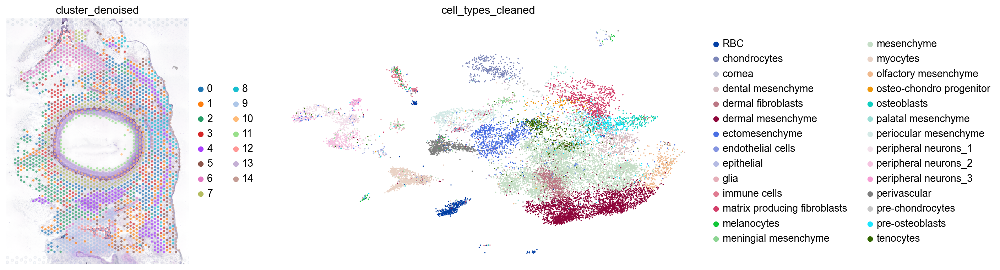

In [41]:
#Plot spatial and ref dataset
fig, axs = plt.subplots(1, 2, figsize=(20, 5))
sc.pl.spatial(
    adata_st, color="cluster_denoised", alpha=0.7, frameon=False, show=False, ax=axs[0]
)
sc.pl.umap(
    adata_sc, color="cell_types_cleaned", size=10, frameon=False, show=False, ax=axs[1]
)
plt.tight_layout()



In [44]:
sc.tl.rank_genes_groups(adata_sc, groupby="cell_types_cleaned", use_raw=False)
markers_df = pd.DataFrame(adata_sc.uns["rank_genes_groups"]["names"]).iloc[0:100, :]
markers = list(np.unique(markers_df.melt().value.values))

In [45]:
tg.pp_adatas(adata_sc, adata_st, genes=markers)

INFO:root:1539 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:16980 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [46]:
ad_map = tg.map_cells_to_space(adata_sc, adata_st,
    mode="clusters",
    cluster_label='cell_types_cleaned',  # .obs field w cell types
    density_prior='rna_count_based',
    num_epochs=500,
     device="cuda:0",
    #device='gpu',
)



INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1539 genes and rna_count_based density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.282, KL reg: 0.073
Score: 0.378, KL reg: 0.000
Score: 0.379, KL reg: 0.000
Score: 0.380, KL reg: 0.000
Score: 0.380, KL reg: 0.000


INFO:root:Saving results..


In [47]:
tg.project_cell_annotations(ad_map, adata_st, annotation="cell_types_cleaned")

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


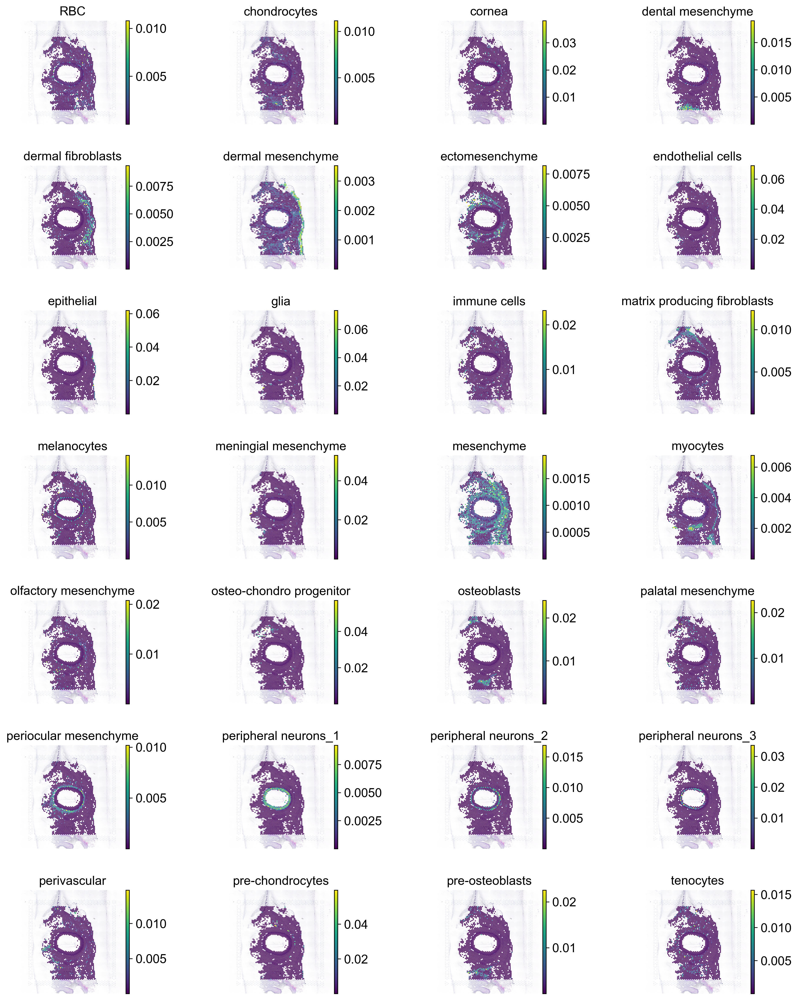

In [48]:
a=ad.AnnData(adata_st.obsm['tangram_ct_pred'])
a.obs=adata_st.obs
a.obsm=adata_st.obsm
a.uns=adata_st.uns


annotation_list = sorted(list(a.obsm['tangram_ct_pred'].columns))

ncol=4
nrows=math.ceil(len(annotation_list)/ncol)

plt.figure(figsize=(16,20),dpi=150)
plt.subplots_adjust(hspace=0.4, wspace=.2)

  

for n, annot in enumerate(annotation_list):
    
    ax = plt.subplot(nrows, ncol, n + 1)
    
    im.show("image",  ax=ax)
    
    sc.pl.spatial(a, 
                  frameon=False,
                  img=None, 
                  color=annot, 
                  show=False,
                  ax=ax,  
                  legend_fontoutline=3,
                  spot_size =60,
                  cmap='viridis')
    ax.invert_yaxis()
    ax.legend_ = None
    
del a
plt.savefig(save_path+'embeddings/'+face+'_W9-5_overlay_cell_annotation_spatial',dpi=150)